# A spatiotemporal analysis of the major types of crime in London

## Preparation

- [Github link](https://github.com/YYY677/DSSS/tree/main/Assessment)

- Number of words: around 1600 words

- Runtime: within 10 mins (*Memory 32 GB, CPU Intel Ultra 9 185H 2.50 GHz*)

- Coding environment: SDS Docker

- License: this notebook is made available under the [Creative Commons Attribution license](https://creativecommons.org/licenses/by/4.0/).

- There is no additional library *[libraries not included in SDS Docker or not used in this module]* being used in this notebook.

In [1]:
import time 
start_time = time.time() 

In [2]:
import pandas as pd
import geopandas as gpd
import os
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from esda.moran import Moran
from esda.getisord import G_Local
from libpysal.weights import Queen
from tabulate import tabulate
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram
from scipy.stats import chi2_contingency

## Table of contents

1. [Introduction](#Introduction)

1. [Research questions](#Research-questions)

1. [Data](#Data)

1. [Methodology](#Methodology)

1. [Results and discussion](#Results-and-discussion)

1. [Conclusion](#Conclusion)

1. [References](#References)

## Introduction

[[ go back to the top ]](#Table-of-contents)

In large metropolitan areas like London, crime patterns are `not randomly distributed` but tend to concentrate in specific locations and fluctuate over time. Identifying these spatiotemporal patterns is crucial for developing effective crime prevention and intervention strategies. As scholars have emphasized, “understanding where and when crimes occur is essential for targeted policing and urban policy design” (Chainey et al., 2008).

Recent advancements in Geographic Information Systems (GIS) and data science have opened up new possibilities for analyzing crime dynamics. Techniques that account for both space and time allow researchers to go beyond traditional static maps and examine how crime hotspots evolve over time (Nakaya & Yano, 2010). Clustering methods, such as hierarchical clustering, have proven to be particularly effective in uncovering hidden patterns and relationships between different crime types (Joshi et al., 2017). These methods provide valuable insights into key questions, such as whether certain crime types tend to co-occur and whether such co-occurrence follows a spatial structure.

This research aims to apply these advanced methods to uncover further insights into crime patterns and explore underlying trends that are not apparent. The findings will provide insights that can inform crime prevention policy, resource allocation, and broader urban planning initiatives.


## Research questions

[[ go back to the top ]](#Table-of-contents)

This study seeks to answer the following questions:

1. How are crime rates distributed over time and space?

2. Are there underlying relationships between different crime types, and are these relationships associated with crime density?


## Data

[[ go back to the top ]](#Table-of-contents)

### Data Description

This study primarily relies on three straightforward datasets:

1. **Most recent 24 months of crime data** at the LSOA level  
2. **Historical crime data** at the LSOA level  
3. **Geographic data** for each LSOA

The only difference between the two crime datasets is the time period they cover. Both datasets share the same structure and include the following columns:

| **Column Name**        | **Description**                                                                 |
|------------------------|---------------------------------------------------------------------------------|
| `LSOA Code`            | A unique identifier for each Lower Layer Super Output Area                       |
| `LSOA Name`            | The name corresponding to each LSOA                                              |
| `Borough`              | A unique identifier for each Borough in which the LSOA is located                        |
| `Major Category`       | The broad category of crime                                                     |
| `Minor Category`       | The specific subcategory of the crime                                            |
| Monthly crime counts   | Each column represents a month, containing the crime counts for that month      |


#### What are Borough and LSOA?

- **Borough**: In London, a borough refers to a local government district. There are 32 London boroughs (e.g., Camden, Hackney, Westminster), each responsible for delivering various public services.
  
- **LSOA (Lower Layer Super Output Area)**: These are small geographic areas designed for statistical reporting in the UK. Each borough contains many LSOAs, and each LSOA typically contains around 1,500 residents. They provide a fine-grained spatial resolution for local analysis.

#### Crime Categories

The `Major Category` field includes 10 broad types of crime:

- ARSON AND CRIMINAL DAMAGE  
- BURGLARY  
- DRUG OFFENCES  
- MISCELLANEOUS CRIMES AGAINST SOCIETY  
- POSSESSION OF WEAPONS  
- PUBLIC ORDER OFFENCES  
- ROBBERY  
- THEFT  
- VEHICLE OFFENCES  
- VIOLENCE AGAINST THE PERSON

Each Major Category contains several `Minor Categories` that describe specific types of crime in more detail. **However**, due to the large number of subcategories, this study focuses **solely** on the Major Category level for clarity and interpretability.

#### Geographic Data

The LSOA geographic dataset provides spatial boundaries for all LSOAs in London. This data allows for the calculation of the **area** of each LSOA and supports spatial analysis and mapping.


In [3]:
# Import crime data

recent_df = pd.read_csv('https://raw.githubusercontent.com/YYY677/DSSS/refs/heads/main/Assessment/data/MPS%20LSOA%20Level%20Crime%20(most%20recent%2024%20months).csv')
historical_df = pd.read_csv('https://raw.githubusercontent.com/YYY677/DSSS/refs/heads/main/Assessment/data/MPS%20LSOA%20Level%20Crime%20(Historical).csv')

In [4]:
# Lets merge these two datasets

df = pd.merge(historical_df, recent_df, on=['LSOA Code', 'LSOA Name', 'Borough', 'Major Category', 'Minor Category'], how='outer').fillna(0).sort_index(axis = 1)
df.head()

,201004,201005,201006,201007,201008,201009,201010,201011,201012,201101,...,202410,202411,202412,202501,Borough,LSOA Code,LSOA Name,Major Category,Minor Category,Refreshed Date
0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,E09000002,E01000006,Barking and Dagenham 016A,ARSON AND CRIMINAL DAMAGE,ARSON,0
1,1.0,3.0,0.0,2.0,0.0,2.0,0.0,1.0,0.0,0.0,...,0.0,2.0,0.0,1.0,E09000002,E01000006,Barking and Dagenham 016A,ARSON AND CRIMINAL DAMAGE,CRIMINAL DAMAGE,05/02/2025
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,E09000002,E01000006,Barking and Dagenham 016A,BURGLARY,BURGLARY - RESIDENTIAL,05/02/2025
3,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,E09000002,E01000006,Barking and Dagenham 016A,BURGLARY,BURGLARY BUSINESS AND COMMUNITY,0
4,3.0,0.0,0.0,1.0,1.0,3.0,1.0,1.0,3.0,2.0,...,0.0,0.0,0.0,0.0,E09000002,E01000006,Barking and Dagenham 016A,BURGLARY,BURGLARY IN A DWELLING,05/02/2025


In [5]:
# calculating the total number of crimes for each year (2011-2024) 
# and aggregates the data by 'LSOA Code', 'Borough', and 'Major Category'.

df_yearly = df.copy()

# Only using data 2014 to 2024
years = range(2011, 2025)

# Iterate through each year and calculate the total
for year in years:
    # Dynamically obtains column names for each year
    cols_to_sum = [col for col in df_yearly.columns if str(year) in str(col)]
    
    # Calculate the total number of crimes for each year
    df_yearly[str(year)] = df_yearly[cols_to_sum].sum(axis=1)

# Create a new dataframe that contains data for each year
df_yearly = df_yearly[["LSOA Code", "Borough", "Major Category"] + [str(year) for year in years]]
df_yearly = df_yearly.groupby(['LSOA Code', "Borough", 'Major Category']).sum().reset_index()

# show the result
df_yearly.head()

,LSOA Code,Borough,Major Category,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024
0,E01000006,E09000002,ARSON AND CRIMINAL DAMAGE,4.0,9.0,5.0,8.0,8.0,8.0,5.0,12.0,7.0,6.0,5.0,6.0,5.0,5.0
1,E01000006,E09000002,BURGLARY,20.0,17.0,14.0,10.0,10.0,7.0,13.0,16.0,13.0,5.0,5.0,3.0,3.0,2.0
2,E01000006,E09000002,DRUG OFFENCES,10.0,1.0,6.0,8.0,6.0,1.0,3.0,14.0,6.0,25.0,16.0,17.0,5.0,3.0
3,E01000006,E09000002,MISCELLANEOUS CRIMES AGAINST SOCIETY,0.0,1.0,1.0,4.0,0.0,1.0,2.0,2.0,4.0,1.0,3.0,5.0,1.0,2.0
4,E01000006,E09000002,POSSESSION OF WEAPONS,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,2.0,0.0,2.0


In [6]:
#load in the LSOA map 

UK_LSOA = gpd.read_file("https://github.com/YYY677/DSSS/raw/refs/heads/main/Assessment/data/LSOA.gpkg")
#calculate the area of each lsoa
UK_LSOA['area_km2'] = UK_LSOA.area*10**-6
UK_LSOA.head()

,lsoa21cd,lsoa21nm,geometry,area_km2
0,E01000001,City of London 001A,"POLYGON ((532151.538 181867.433, 532152.5 1818...",0.129865
1,E01000002,City of London 001B,"POLYGON ((532634.497 181926.016, 532632.048 18...",0.228420
2,E01000003,City of London 001C,"POLYGON ((532153.703 182165.155, 532158.25 182...",0.059054
3,E01000005,City of London 001E,"POLYGON ((533619.062 181402.364, 533639.868 18...",0.189578
4,E01000006,Barking and Dagenham 016A,"POLYGON ((545126.852 184310.838, 545145.213 18...",0.146537


## Methodology

[[ go back to the top ]](#Table-of-contents)

This study employed a comprehensive spatiotemporal analysis to examine crime patterns across London. The methodology consists of the following key steps:

1. **Data Aggregation and Preprocessing**  
   Crime data were aggregated by type, year, and location (LSOA). The data were then normalized by LSOA area to compute crime density.

2. **Temporal Trend Analysis**  
   Line charts and heatmaps were used to explore annual and monthly fluctuations in total crimes and each major crime category over the past decade.

3. **Spatial Visualization**  
   The spatial distribution of crime rates across LSOAs was visualized using quantile-based choropleth maps for each year, also allowing for identification of persistent hotspots.

4. **Cluster Analysis**  
   Agglomerative hierarchical clustering was applied based on crime-type compositions. A dendrogram was used to determine the optimal number of clusters.

5. **Statistical Testing**  
   Chi-square tests were conducted to assess associations between cluster types and crime density levels, revealing non-random spatial patterns.


`Flow chart of analysis for Question 1:`

<img src="./img/1.jpg" alt="Flow chart of analysis for Question 1" style="display: block; margin: auto;" />


`Flow chart of analysis for Question 2:`

<img src="./img/2.jpg" alt="Flow chart of analysis for Question 2" style="display: block; margin: auto;" />


## Results and discussion

[[ go back to the top ]](#Table-of-contents)

### Temporal distribution of crime rate

`Trend chart of frequency`

In [7]:
# Timeseries of each Major Category. What are trends of each major category like?
drop_list = ['LSOA Code', 'Borough']
cate_grouped_yearly = df_yearly.groupby(by=['Major Category']).agg('sum').drop(columns=drop_list)

cate_grouped_yearly.head()

,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024
Major Category,,,,,,,,,,,,,,
ARSON AND CRIMINAL DAMAGE,75996.0,64730.0,54764.0,57314.0,61020.0,62106.0,61604.0,56324.0,55500.0,49982.0,51781.0,51942.0,56048.0,55138.0
BURGLARY,100836.0,97910.0,87187.0,75886.0,70489.0,68306.0,75975.0,80291.0,80362.0,60216.0,52318.0,51660.0,55434.0,52492.0
DRUG OFFENCES,64931.0,55755.0,50292.0,44400.0,39823.0,39592.0,36528.0,36084.0,47455.0,54571.0,45372.0,43358.0,38284.0,38063.0
MISCELLANEOUS CRIMES AGAINST SOCIETY,8768.0,8130.0,7727.0,8823.0,9979.0,11346.0,11190.0,11005.0,11143.0,11070.0,11130.0,11709.0,11003.0,10081.0
POSSESSION OF WEAPONS,5550.0,4286.0,3992.0,4322.0,4788.0,5843.0,7726.0,7685.0,7257.0,6725.0,5975.0,6278.0,6266.0,4522.0


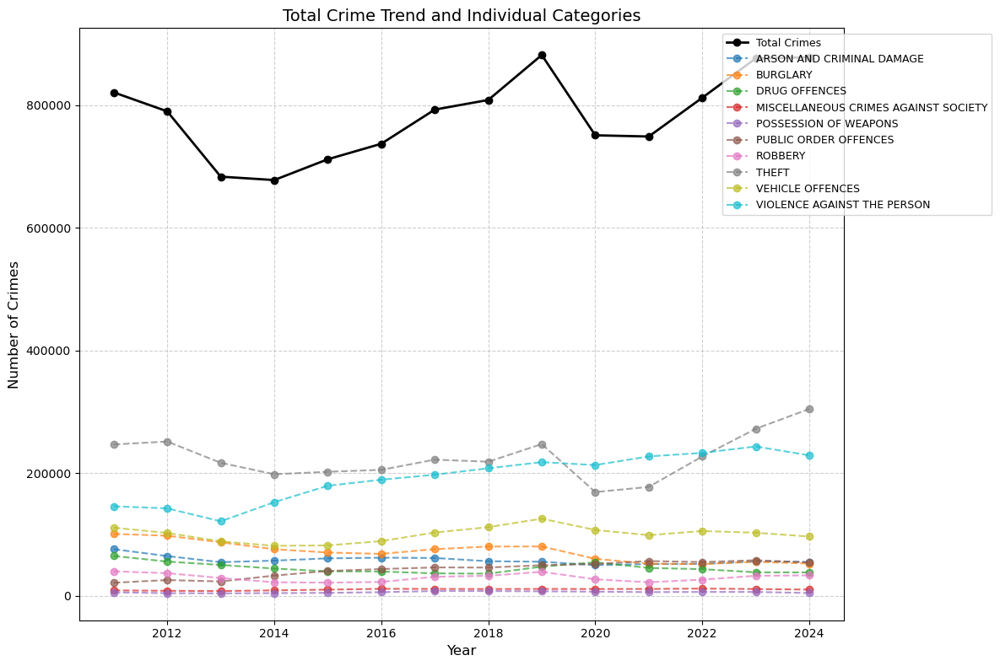

In [8]:
# Get years
years = cate_grouped_yearly.columns.astype(int)

# Calculating the total count of crimes in each year
total_crimes = cate_grouped_yearly.sum()

# Plot trends for total count of crimes
plt.figure(figsize=(12, 8))
plt.plot(years, total_crimes, marker='o', linestyle='-', color='black', linewidth=2, label='Total Crimes')

# Plot trends for individual crime types
for category in cate_grouped_yearly.index:
    plt.plot(years, cate_grouped_yearly.loc[category], marker='o', linestyle='--', label=category, alpha=0.7)

plt.title("Total Crime Trend and Individual Categories", fontsize=14)
plt.xlabel("Year", fontsize=12)
plt.ylabel("Number of Crimes", fontsize=12)
plt.legend(fontsize=9, loc='upper right', bbox_to_anchor=(1.2, 1))
plt.grid(True, linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()


`Monthly Heatmaps of Major Crime Categories`

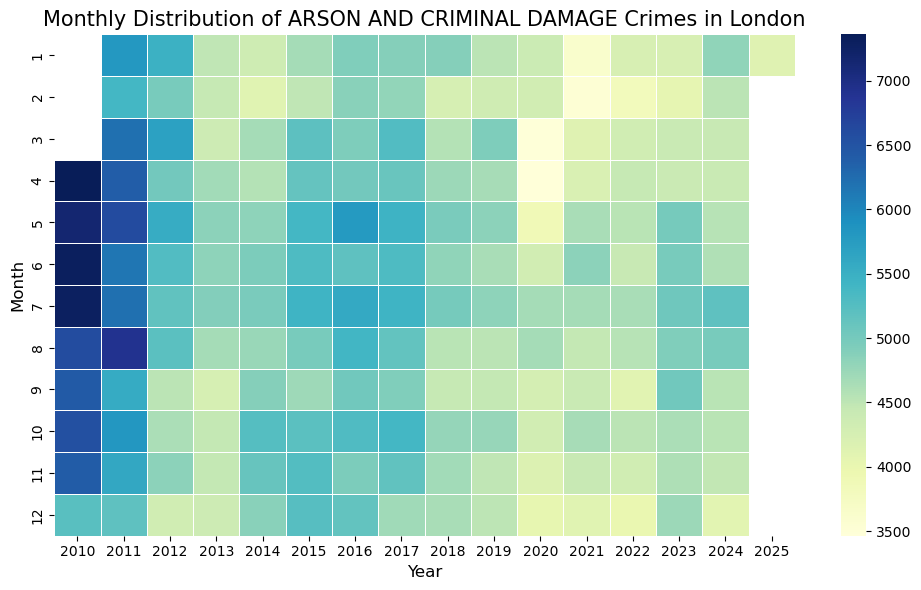

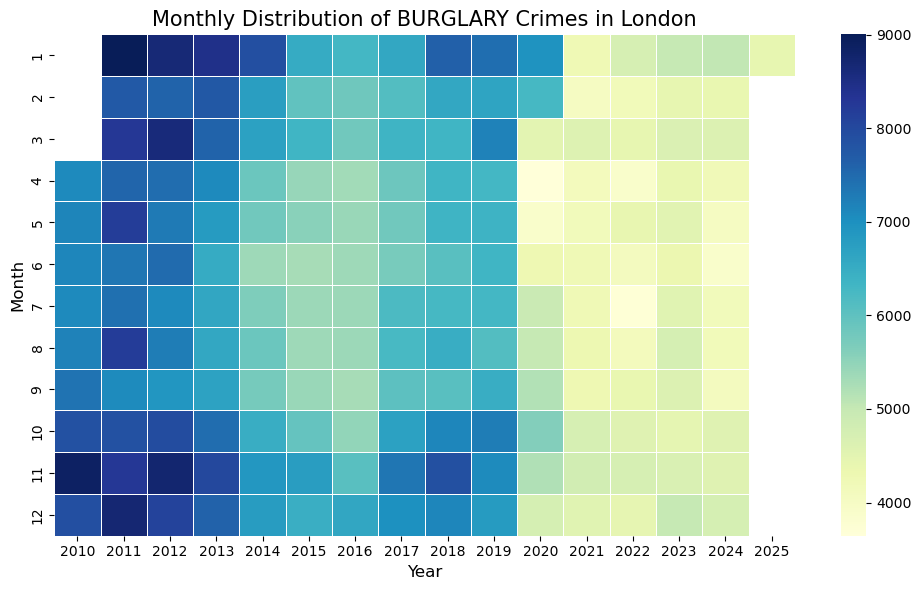

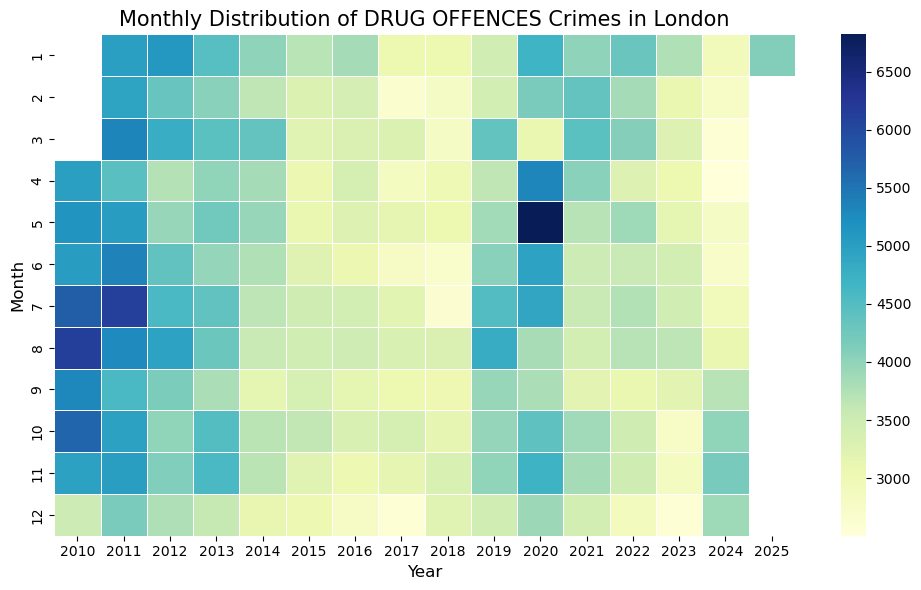

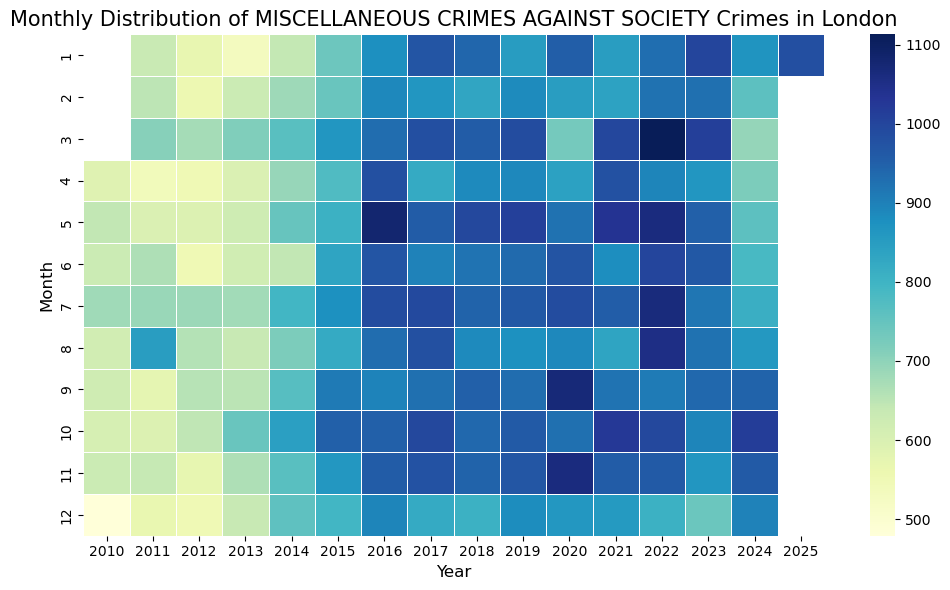

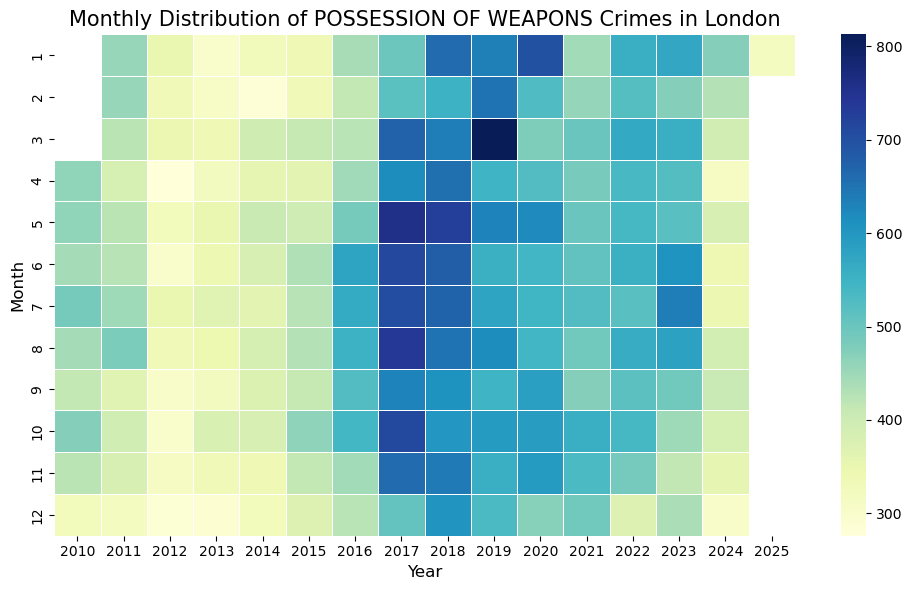

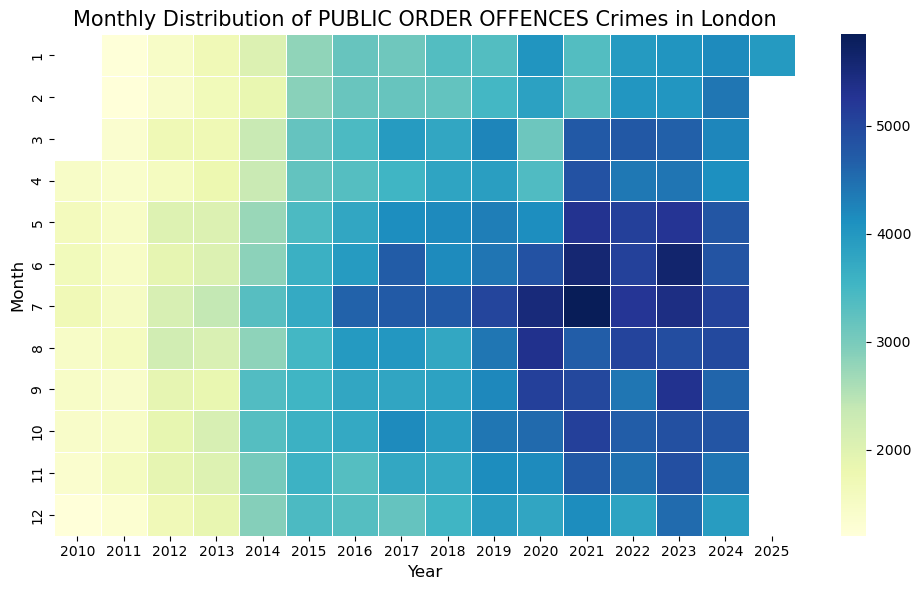

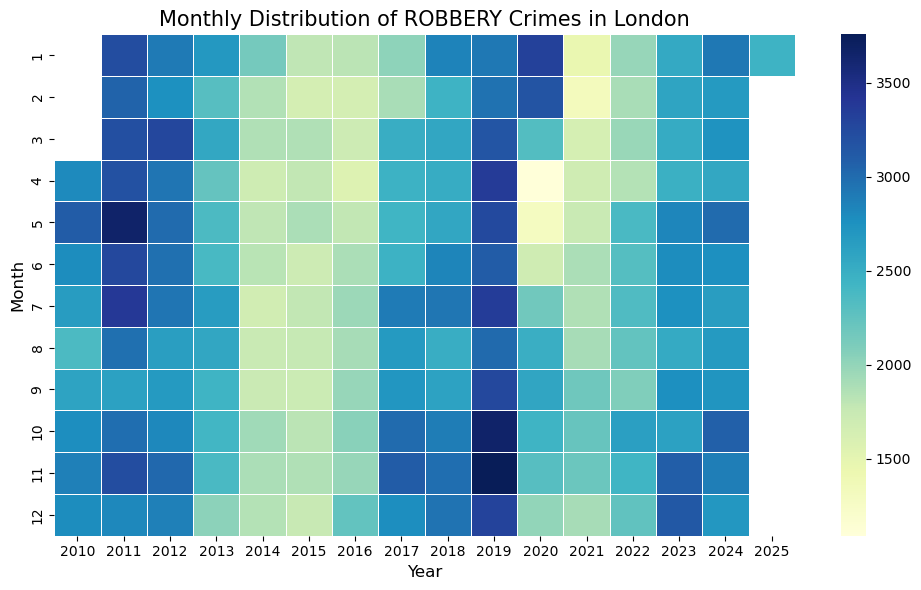

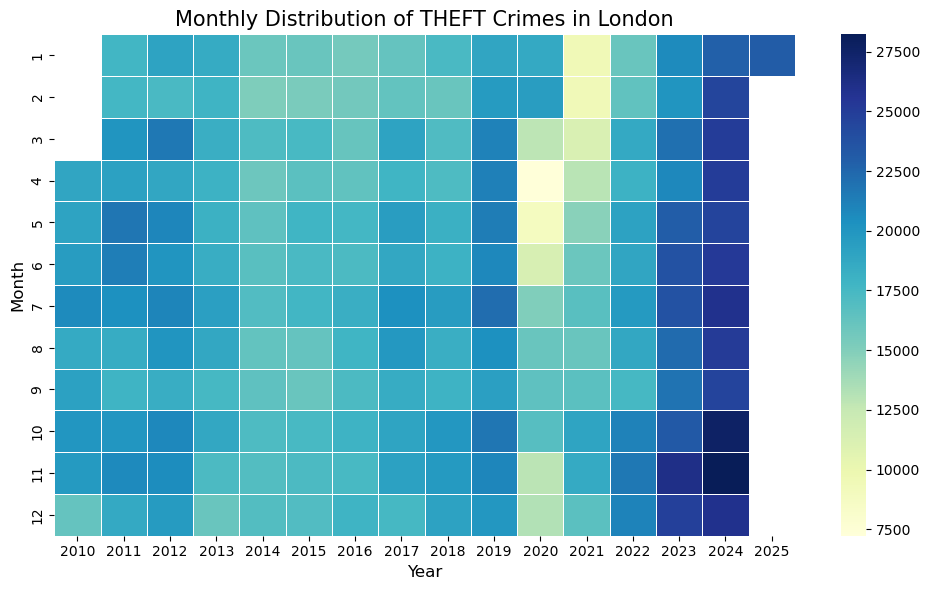

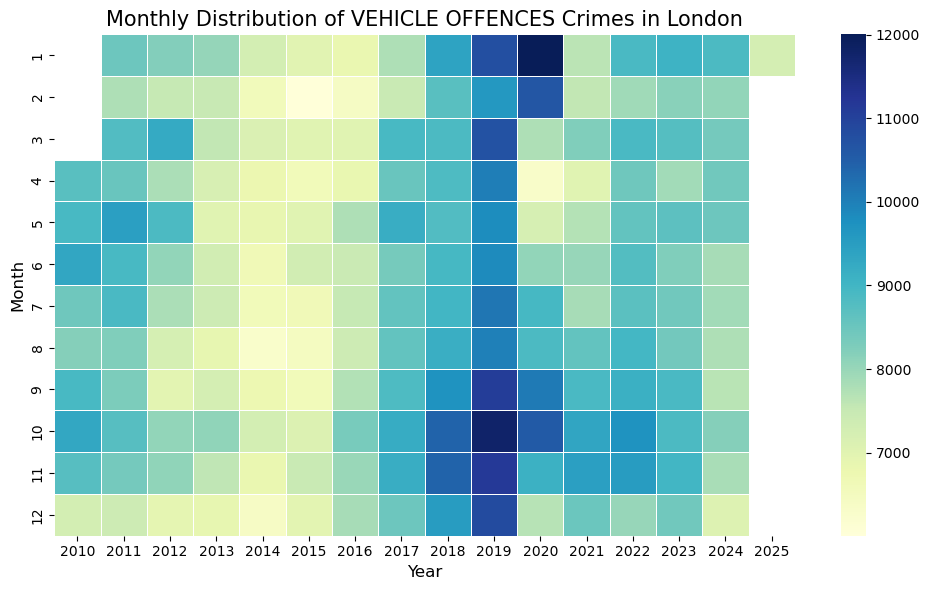

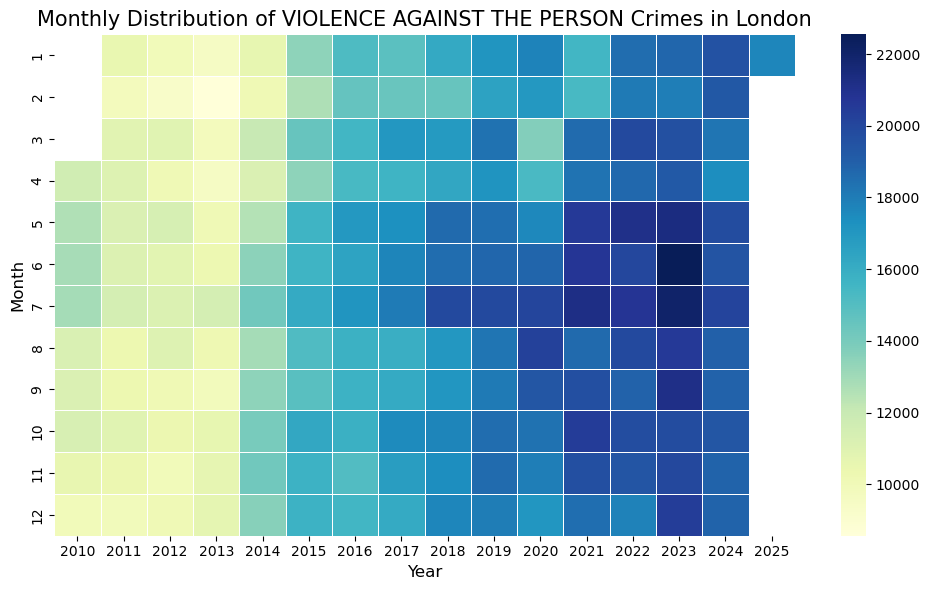

In [9]:
# Select only numeric columns (i.e., monthly crime counts)
numeric_cols = df.select_dtypes(include=['number']).columns

# Get all unique major crime categories
major_categories = df['Major Category'].unique()

# Loop through each crime category and plot one figure per category
for cat in major_categories:
    # Filter data for the current crime category
    filtered_data = df[df['Major Category'] == cat]

    # Re-confirm numeric columns within the filtered data
    numeric_cols = filtered_data.select_dtypes(include=['number']).columns

    # Sum crime counts across all LSOAs for each month
    monthly_sum = filtered_data[numeric_cols].sum()

    # Convert to DataFrame
    grouped_df = monthly_sum.reset_index()
    grouped_df.columns = ['Date', 'Count']

    # Extract month and year from the date string (e.g., "202401")
    grouped_df['Month'] = grouped_df['Date'].str[4:6].astype(int)
    grouped_df['Year'] = grouped_df['Date'].str[:4]

    # Pivot for heatmap: rows are months, columns are years
    monthly_pivot = grouped_df.pivot(index='Month', columns='Year', values='Count')

    # Plot heatmap
    plt.figure(figsize=(10, 6))
    sns.heatmap(monthly_pivot, cmap="YlGnBu", linewidths=.5)
    plt.title(f'Monthly Distribution of {cat} Crimes in London', fontsize=15)
    plt.xlabel('Year', fontsize=12)
    plt.ylabel('Month', fontsize=12)
    plt.tight_layout()
    plt.show()


#### 📊 Time Series Analysis Summary

- **Overall Trends**:  
  The general level of crime in London has shown **significant fluctuations** in recent years, with a **slightly increasing overall trend**.

- **Top Crime Types by Volume**:  
  The most prevalent types of crimes in terms of volume are:
  - **Theft**
  - **Violence Against the Person**
  - **Vehicle Offences**
  - **Burglary**

- **Crimes with Noticeable Decrease in Frequency**:
  - **Arson and Criminal Damage**
  - **Burglary**
  - **Drug Offences**

- **Crimes with Noticeable Increase in Frequency**:
  - **Miscellaneous Crimes Against Society**
  - **Possession of Weapons**
  - **Public Order Offences**
  - **Theft**
  - **Violence Against the Person**


### Spatial distribution of crime rate 

`Plots of Crime Rates by Major Category and LSOA`

In [10]:
# Function to plot crime rate distribution maps
def plot_crime_rate_by_lsoa(years, major_cat, n_quantiles=7):
    """
    Function to plot crime rate per LSOA for each year.

    Parameters:
    years: List of years to plot.
    major_cat: Crime category to plot.
    n_quantiles: Number of quantiles to split crime rate distribution.
    """
    filtered_data = df_yearly[df_yearly['Major Category'] == major_cat].copy()

    # Merge crime data with geographic data
    merged_cat = UK_LSOA.merge(filtered_data, left_on='lsoa21cd', right_on='LSOA Code', how='left')

    # Calculate area-normalized crime rate (crimes per km²) for each LSOA
    for year in years:
        merged_cat[f'{year}_area'] = merged_cat[str(year)] / merged_cat['area_km2']

    # Set layout: 3 columns per row
    ncols = 3
    num_years = len(years)
    nrows = -(-num_years // ncols)  # Ceiling division
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols * 5, nrows * 4.5))
    axes = axes.flatten()

    # Plot maps for each year
    for i, year in enumerate(years):
        ax = axes[i]
        year_str = f'{year}_area'

        # Drop NaNs for quantile calculation
        year_data = merged_cat[year_str].dropna()

        # Compute quantile-based bins
        _, bins = pd.qcut(year_data, q=n_quantiles, retbins=True, duplicates="drop")
        unique_cutpoints = np.unique(bins.round(2))
        unique_cutpoints = unique_cutpoints[1:-1]  # Drop min/max edge bins

        # Plot map
        merged_cat.plot(
            column=year_str, cmap='RdBu_r', linewidth=0, ax=ax,
            legend=True, scheme='user_defined',
            classification_kwds={'bins': unique_cutpoints},
            legend_kwds={
                'fontsize': 9,
                'markerscale': 0.5,
                'loc': 'lower right',
                'frameon': True,
                'title': 'Rate'
            },
            missing_kwds={
                'color': 'lightgrey',
                'hatch': '///',
                'label': 'Missing'
            }
        )

        ax.set_title(f'{major_cat} Rate\n{year} (per km²)', fontsize=12)
        ax.axis('off')

    # Remove unused subplots if any
    for i in range(num_years, len(axes)):
        fig.delaxes(axes[i])

    # Adjust spacing between subplots
    plt.subplots_adjust(hspace=0, wspace=0)
    plt.tight_layout()
    plt.show()


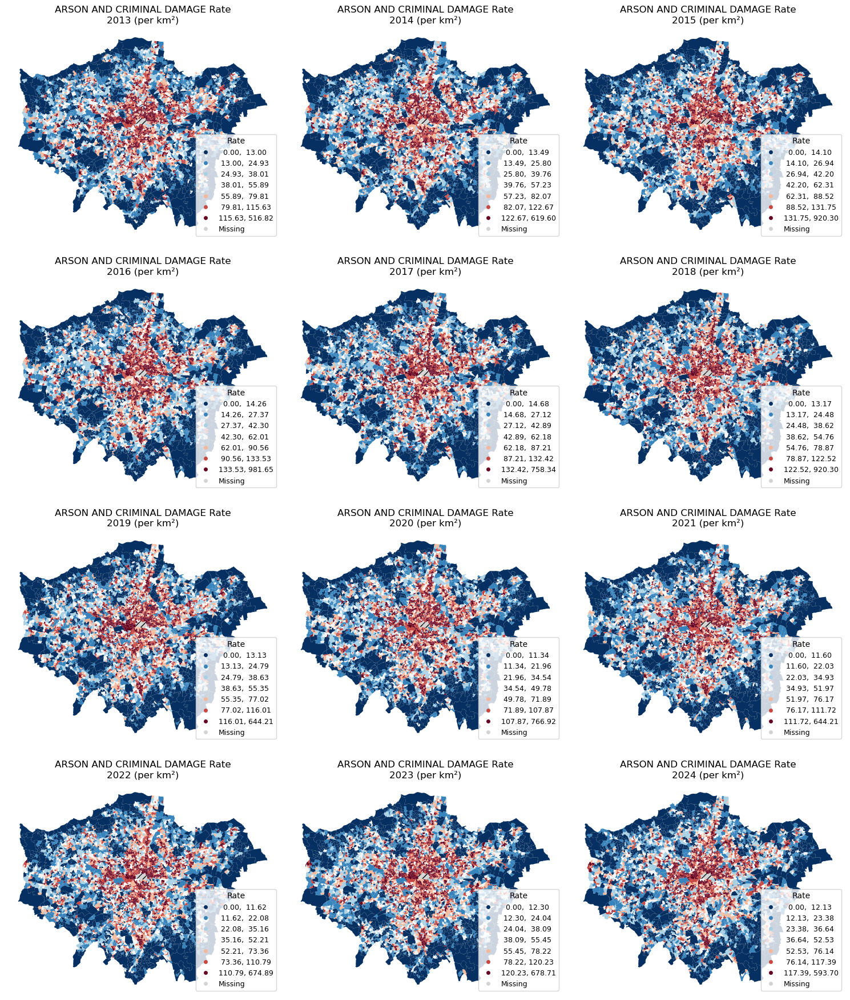

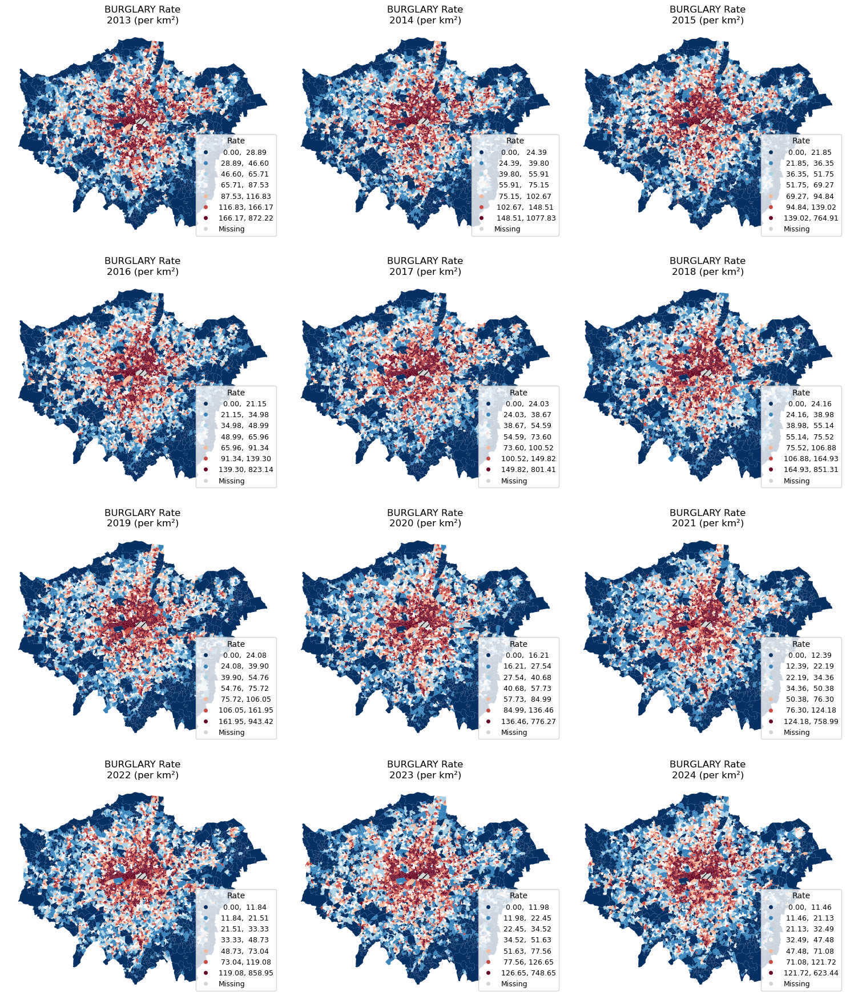

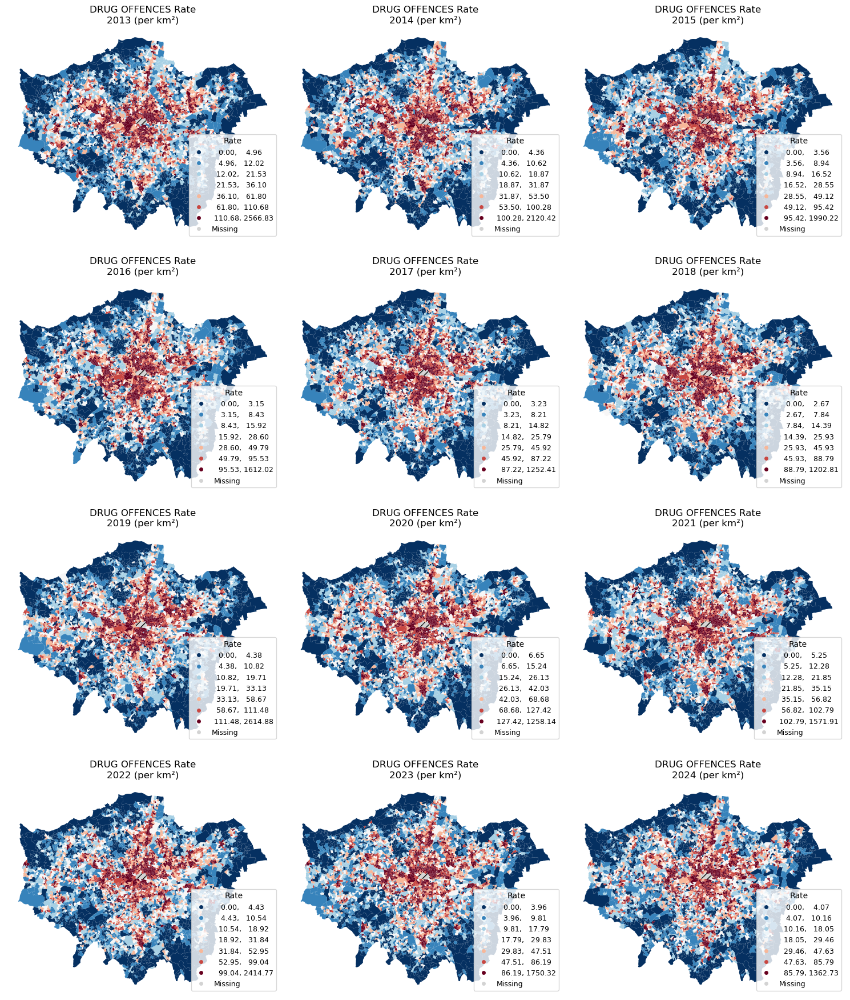

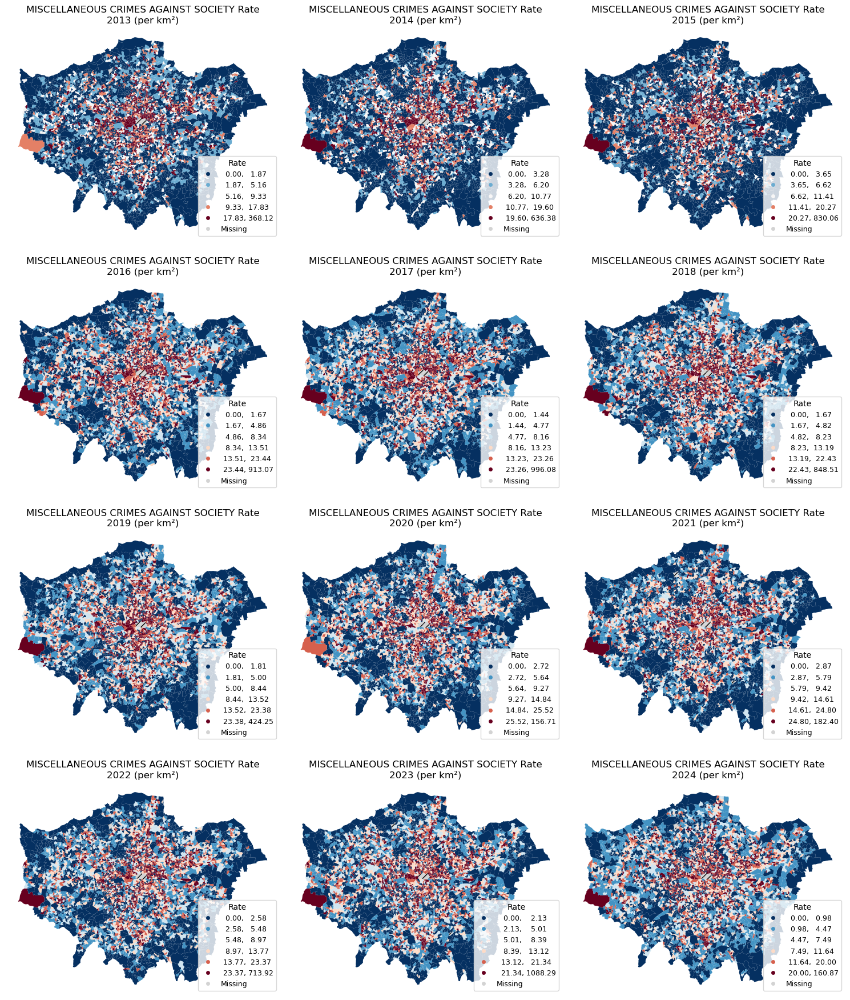

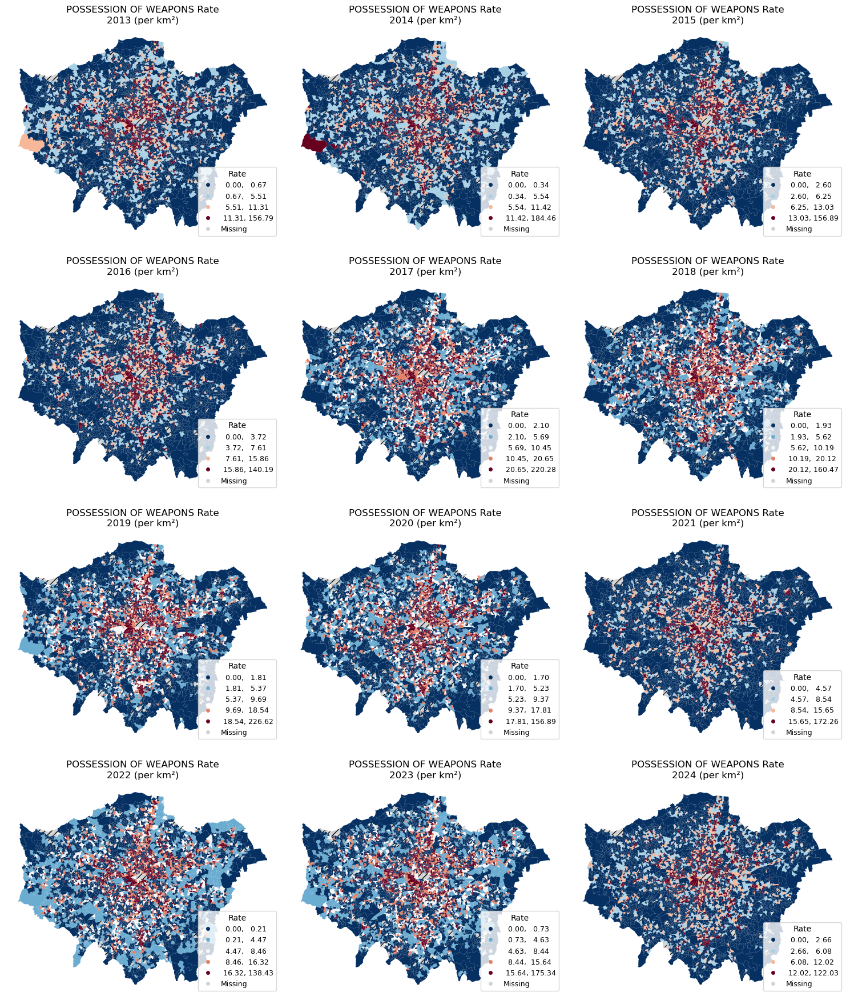

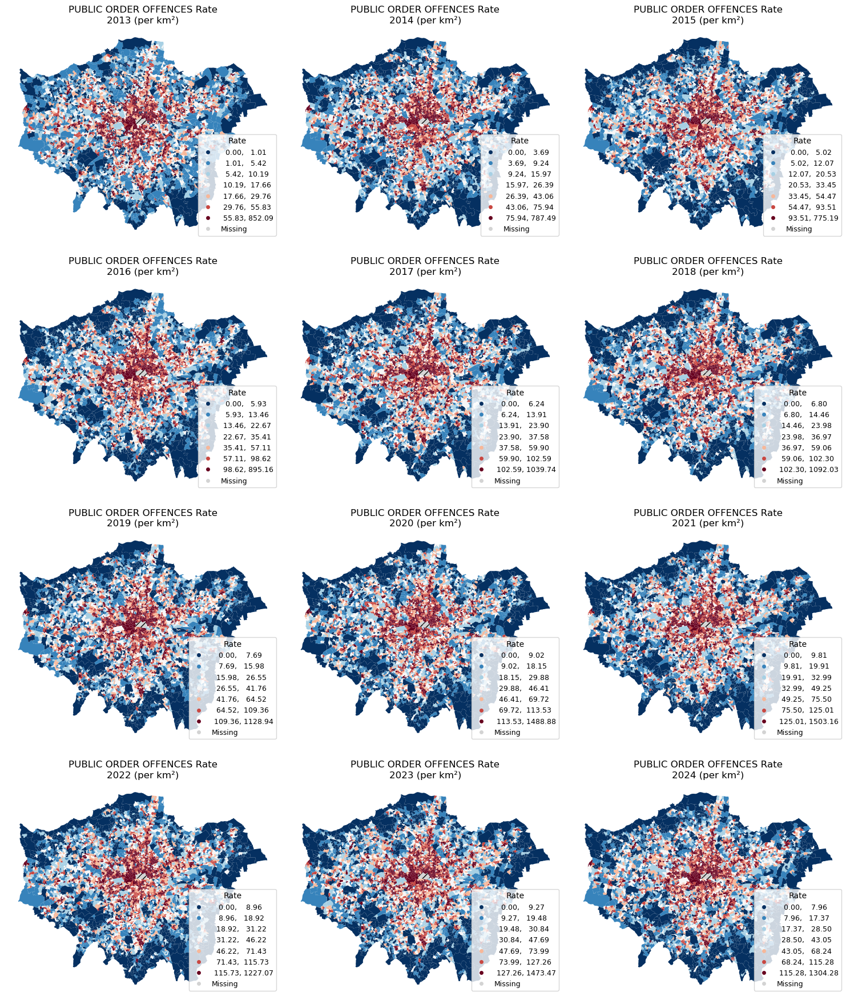

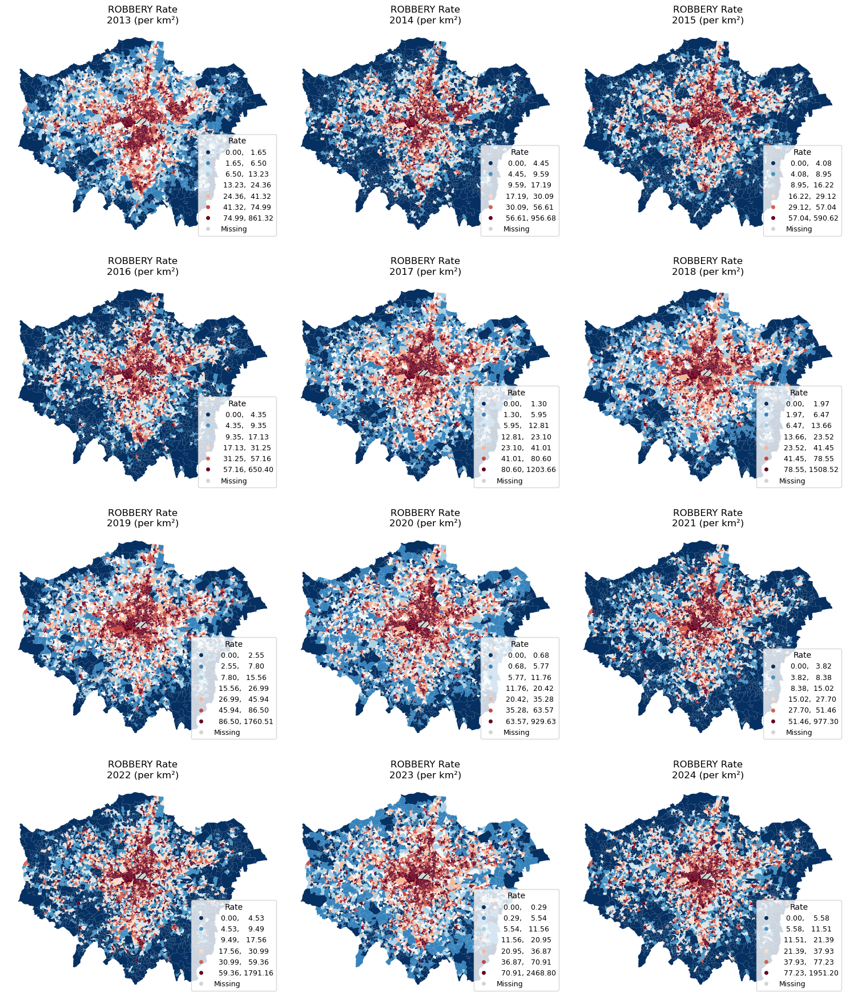

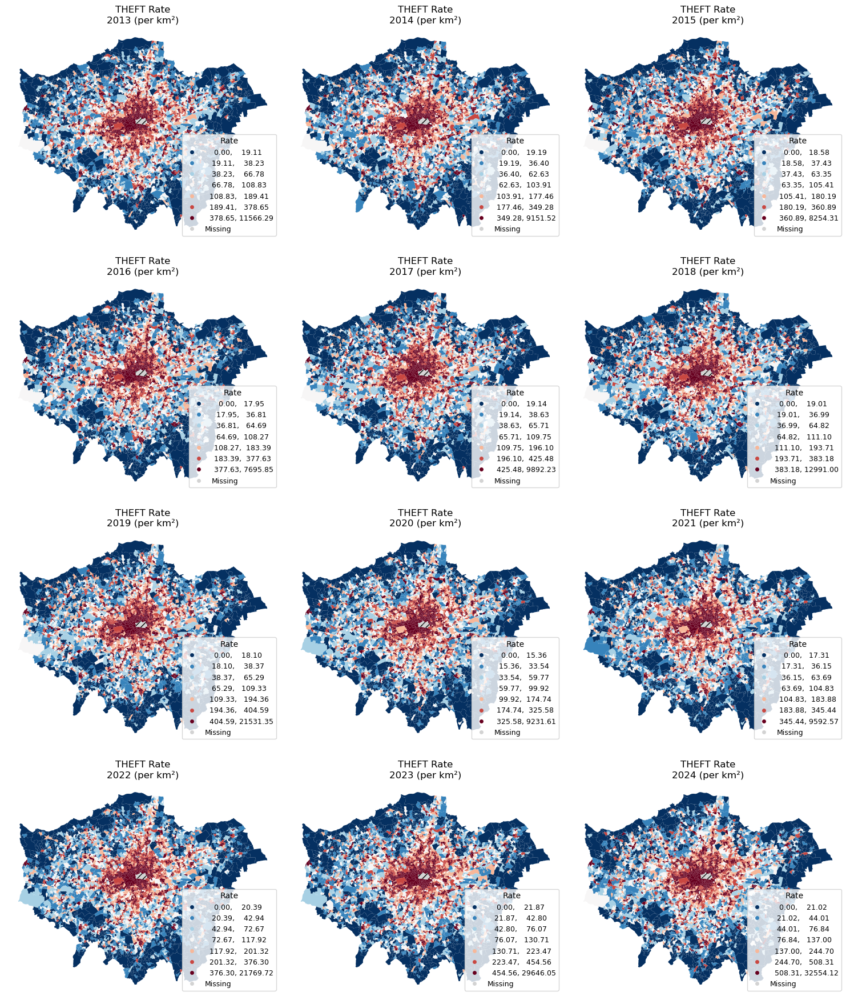

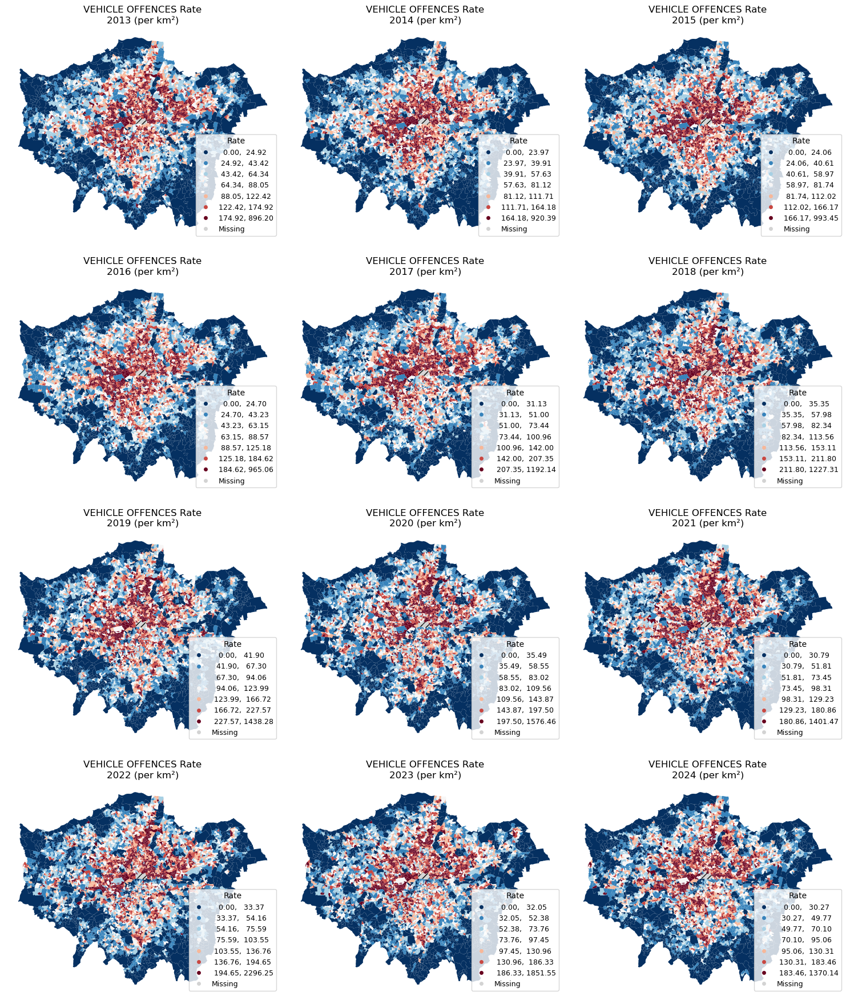

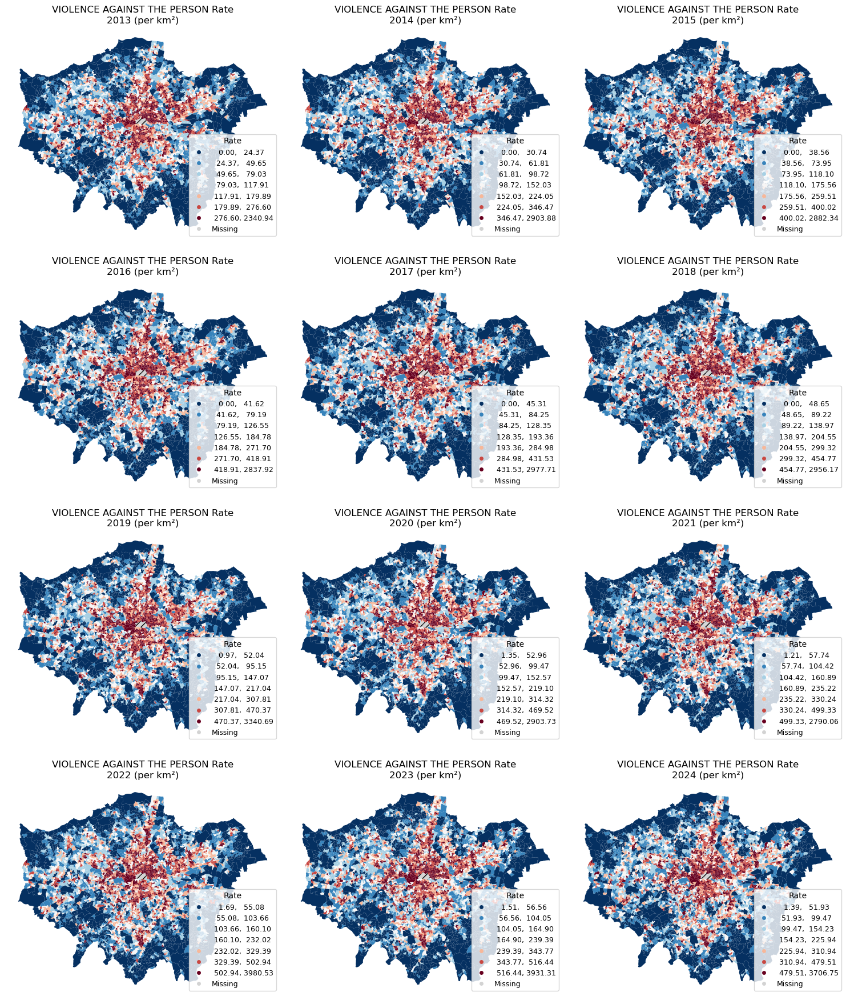

In [11]:
years = ['2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023', '2024']
major_categories = df_yearly['Major Category'].unique()
for major_cat in major_categories:
  plot_crime_rate_by_lsoa(years, major_cat)

`Plots of total crime rate by LSOA`

In [12]:
def for_all_types(lsoa_grouped_yearly, years, n_quantiles=7):
    """
    Function to plot crime rate distribution for each year.

    Parameters:
    lsoa_grouped_yearly: GeoDataFrame with crime data aggregated by LSOA and year
    years: List of years to plot.
    n_quantiles: Number of quantiles to split crime rate distribution.
    """
    # Merge geographic and crime data
    merged_cat = UK_LSOA.merge(lsoa_grouped_yearly, left_on='lsoa21cd', right_on='LSOA Code', how='left')

    # Calculate area-normalized crime rate (crimes per km²) for each LSOA and each year
    for year in years:
        merged_cat[f'{year}_area'] = merged_cat[str(year)] / merged_cat['area_km2']

    # Set layout: 3 columns per row
    ncols = 3
    num_years = len(years)
    nrows = -(-num_years // ncols)  # Ceiling division
    fig, axes = plt.subplots(nrows, ncols, figsize=(ncols * 5, nrows * 4.5))
    axes = axes.flatten()

    # Plot maps for each year
    for i, year in enumerate(years):
        ax = axes[i]
        year_str = f'{year}_area'

        year_data = merged_cat[year_str].dropna()
        _, bins = pd.qcut(year_data, q=n_quantiles, retbins=True, duplicates="drop")
        unique_cutpoints = np.unique(bins.round(2))
        unique_cutpoints = unique_cutpoints[1:-1]

        merged_cat.plot(
            column=year_str, cmap='RdBu_r', linewidth=0, ax=ax,
            legend=True, scheme='user_defined',
            classification_kwds={'bins': unique_cutpoints},
            legend_kwds={
                'fontsize': 9,
                'markerscale': 0.5,
                'loc': 'lower right',
                'frameon': True,
                'title': 'Rate'
            },
            missing_kwds={
                'color': 'lightgrey',
                'hatch': '///',
                'label': 'Missing'
            }
        )

        ax.set_title(f'Total Crime Rate\nLondon LSOAs - {year} (per km²)', fontsize=12)
        ax.axis('off')

    # Remove unused subplots
    for i in range(num_years, len(axes)):
        fig.delaxes(axes[i])

    # Adjust spacing
    plt.subplots_adjust(hspace=0.1, wspace=0.05)
    plt.tight_layout()
    plt.show()


In [13]:
# Timeseries of each Major Category. What are trends of each major category like?
drop_list = ['Major Category', 'Borough']
lsoa_grouped_yearly = df_yearly.groupby(by=['LSOA Code']).agg('sum').drop(columns=drop_list)

lsoa_grouped_yearly.head()

,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023,2024
LSOA Code,,,,,,,,,,,,,,
E01000006,107.0,100.0,93.0,73.0,82.0,79.0,95.0,113.0,108.0,103.0,94.0,119.0,87.0,89.0
E01000007,403.0,366.0,312.0,269.0,385.0,370.0,442.0,387.0,519.0,529.0,507.0,473.0,647.0,521.0
E01000008,178.0,130.0,131.0,176.0,196.0,180.0,172.0,194.0,213.0,192.0,224.0,210.0,234.0,135.0
E01000009,337.0,278.0,222.0,234.0,241.0,183.0,189.0,248.0,270.0,292.0,298.0,294.0,376.0,243.0
E01000011,113.0,108.0,81.0,99.0,70.0,108.0,95.0,101.0,91.0,107.0,111.0,103.0,121.0,115.0


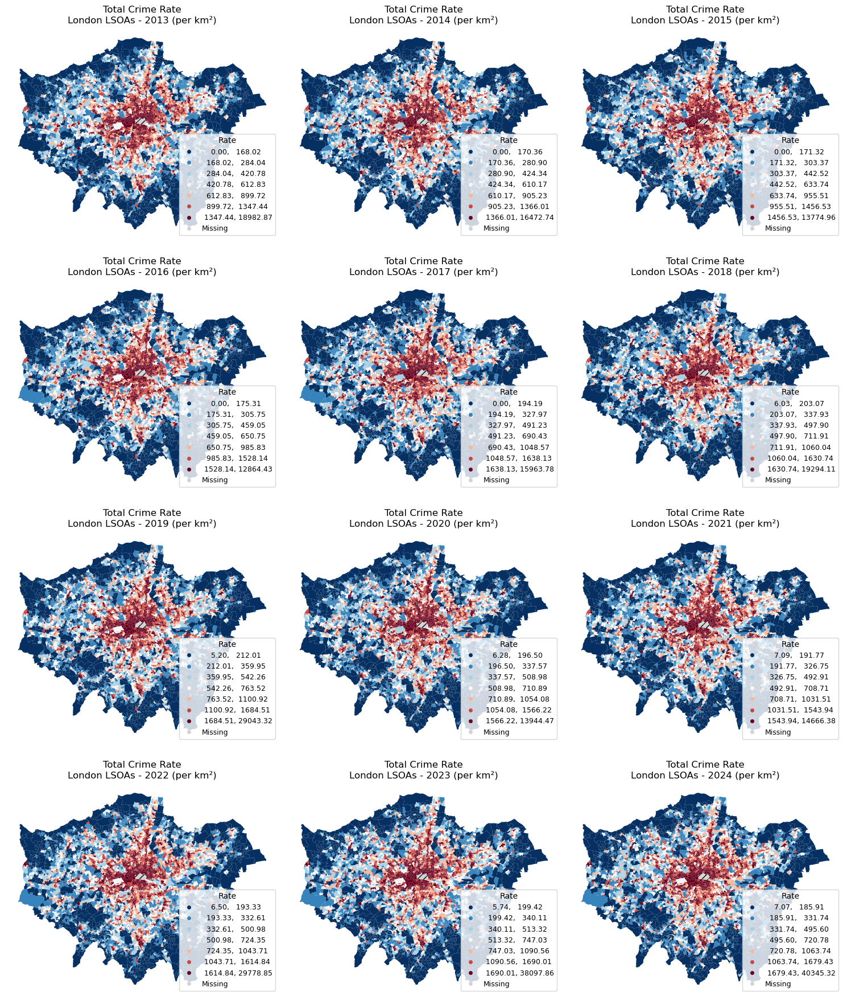

In [14]:
for_all_types(lsoa_grouped_yearly, years)

#### 🗺️ Spatial Distribution Analysis Summary

Based on the visualisation above, the following conclusions can be drawn:

1. **Different crime types exhibit significant spatial differences** in their distribution patterns.  
   For example:
   - **Theft rate** is highly concentrated in central London.
   - In contrast, **Crimes Against Society rate** is more widely distributed across the city.

2. The spatial distribution patterns of each crime type have **remained relatively stable over the past decade**, especially in terms of the **location of crime hotspots**. But there are 2 things to note:
   - Crime types with more concentrated crime density have more stable spatial distributions, such as **Burglary** and **Theft**.
   - Some cold spot areas may appear to fluctuate significantly across years, but this is often due to their very low values (even close to 0), making them more susceptible to variation, such as the Robbery rate in 2023.

---

Given these observations, we find that **each type of crime displays distinct and relatively stable spatial characteristics**. This stability provides support for the **validity of the clustering results**, as it indicates that the underlying spatial structures are not random but persist across years. Therefore, in the next section, we will apply **clustering analysis** to further explore the **potential relationships between different crime types**.


### Cluster analysis

`Why 2022 to 2024?`
- The most **recent** data, so it more accurately reflects the current situation.
- Avoids the influence of **covid-19 pandemic**, which is a outlier for normal circumstances. 

In [15]:
# Get the median

df_yearly['median'] = df_yearly.loc[:, '2022':'2024'].median(axis=1)
crime_median = df_yearly[["LSOA Code", "Major Category", "median"]]
crime_median.head()

,LSOA Code,Major Category,median
0,E01000006,ARSON AND CRIMINAL DAMAGE,5.0
1,E01000006,BURGLARY,3.0
2,E01000006,DRUG OFFENCES,5.0
3,E01000006,MISCELLANEOUS CRIMES AGAINST SOCIETY,2.0
4,E01000006,POSSESSION OF WEAPONS,2.0


In [16]:
# pivot the table

crime_median = crime_median.pivot_table(index= 'LSOA Code', columns = 'Major Category', 
                                    values = "median", fill_value = 0).reset_index()
#then rename the axis
crime_median.rename_axis(None, axis=1, inplace=True)
crime_median.head()

,LSOA Code,ARSON AND CRIMINAL DAMAGE,BURGLARY,DRUG OFFENCES,MISCELLANEOUS CRIMES AGAINST SOCIETY,POSSESSION OF WEAPONS,PUBLIC ORDER OFFENCES,ROBBERY,THEFT,VEHICLE OFFENCES,VIOLENCE AGAINST THE PERSON
0,E01000006,5.0,3.0,5.0,2.0,2.0,6.0,6.0,13.0,21.0,34.0
1,E01000007,32.0,22.0,72.0,2.0,6.0,43.0,39.0,138.0,23.0,156.0
2,E01000008,14.0,13.0,27.0,3.0,3.0,7.0,6.0,27.0,32.0,61.0
3,E01000009,24.0,12.0,57.0,3.0,2.0,15.0,14.0,58.0,22.0,94.0
4,E01000011,5.0,5.0,10.0,4.0,1.0,3.0,5.0,12.0,12.0,54.0


In [17]:
# calculate all crimes of each lsoa

#extract the columns to sum
cols_to_sum = [col for col in crime_median.columns if "LSOA" not in col]
#sum across the columns rather than rows
crime_median['Total_crime'] = 0
#sum across the columns rather than rows
crime_median["Total_crime"] = crime_median[cols_to_sum].sum(axis=1)
crime_median.head()

,LSOA Code,ARSON AND CRIMINAL DAMAGE,BURGLARY,DRUG OFFENCES,MISCELLANEOUS CRIMES AGAINST SOCIETY,POSSESSION OF WEAPONS,PUBLIC ORDER OFFENCES,ROBBERY,THEFT,VEHICLE OFFENCES,VIOLENCE AGAINST THE PERSON,Total_crime
0,E01000006,5.0,3.0,5.0,2.0,2.0,6.0,6.0,13.0,21.0,34.0,97.0
1,E01000007,32.0,22.0,72.0,2.0,6.0,43.0,39.0,138.0,23.0,156.0,533.0
2,E01000008,14.0,13.0,27.0,3.0,3.0,7.0,6.0,27.0,32.0,61.0,193.0
3,E01000009,24.0,12.0,57.0,3.0,2.0,15.0,14.0,58.0,22.0,94.0,301.0
4,E01000011,5.0,5.0,10.0,4.0,1.0,3.0,5.0,12.0,12.0,54.0,111.0


In [18]:
# Percentage normalization

for col in cols_to_sum:
    crime_median[col] = (crime_median[col] / crime_median["Total_crime"]).round(4)
crime_median.head()

,LSOA Code,ARSON AND CRIMINAL DAMAGE,BURGLARY,DRUG OFFENCES,MISCELLANEOUS CRIMES AGAINST SOCIETY,POSSESSION OF WEAPONS,PUBLIC ORDER OFFENCES,ROBBERY,THEFT,VEHICLE OFFENCES,VIOLENCE AGAINST THE PERSON,Total_crime
0,E01000006,0.0515,0.0309,0.0515,0.0206,0.0206,0.0619,0.0619,0.1340,0.2165,0.3505,97.0
1,E01000007,0.0600,0.0413,0.1351,0.0038,0.0113,0.0807,0.0732,0.2589,0.0432,0.2927,533.0
2,E01000008,0.0725,0.0674,0.1399,0.0155,0.0155,0.0363,0.0311,0.1399,0.1658,0.3161,193.0
3,E01000009,0.0797,0.0399,0.1894,0.0100,0.0066,0.0498,0.0465,0.1927,0.0731,0.3123,301.0
4,E01000011,0.0450,0.0450,0.0901,0.0360,0.0090,0.0270,0.0450,0.1081,0.1081,0.4865,111.0


In [19]:
# merged with geographic data, and calculating crime density (per square kilometer)

london_crime_median = UK_LSOA.merge(crime_median, left_on="lsoa21cd", right_on="LSOA Code", how="right").drop(columns='LSOA Code')
london_crime_median['crime_per_km2'] = london_crime_median['Total_crime'] / london_crime_median['area_km2']
london_crime_median.head()


,lsoa21cd,lsoa21nm,geometry,area_km2,ARSON AND CRIMINAL DAMAGE,BURGLARY,DRUG OFFENCES,MISCELLANEOUS CRIMES AGAINST SOCIETY,POSSESSION OF WEAPONS,PUBLIC ORDER OFFENCES,ROBBERY,THEFT,VEHICLE OFFENCES,VIOLENCE AGAINST THE PERSON,Total_crime,crime_per_km2
0,E01000006,Barking and Dagenham 016A,"POLYGON ((545126.852 184310.838, 545145.213 18...",0.146537,0.0515,0.0309,0.0515,0.0206,0.0206,0.0619,0.0619,0.1340,0.2165,0.3505,97.0,661.948879
1,E01000007,Barking and Dagenham 015A,"POLYGON ((544173.015 184701.354, 544180.164 18...",0.200094,0.0600,0.0413,0.1351,0.0038,0.0113,0.0807,0.0732,0.2589,0.0432,0.2927,533.0,2663.748136
2,E01000008,Barking and Dagenham 015B,"POLYGON ((543570.116 184563.91, 543581.835 184...",0.216901,0.0725,0.0674,0.1399,0.0155,0.0155,0.0363,0.0311,0.1399,0.1658,0.3161,193.0,889.805255
3,E01000009,Barking and Dagenham 016B,"POLYGON ((544602.706 184628.237, 544605.228 18...",0.127960,0.0797,0.0399,0.1894,0.0100,0.0066,0.0498,0.0465,0.1927,0.0731,0.3123,301.0,2352.298926
4,E01000011,Barking and Dagenham 016C,"POLYGON ((544607.954 184727.846, 544620.667 18...",0.091632,0.0450,0.0450,0.0901,0.0360,0.0090,0.0270,0.0450,0.1081,0.1081,0.4865,111.0,1211.363486


`Dendrogram`

In [20]:
def plot_dendrogram(model, **kwargs):
    
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count +=1
            else:
                current_count += counts[child_idx-n_samples]
        counts[i] = current_count
        
    linkage_matrix = np.column_stack([model.children_, model.distances_,
                                    counts]).astype(float)
    
    dendrogram(linkage_matrix, **kwargs)

In [21]:
crime_clus_median = london_crime_median[cols_to_sum]

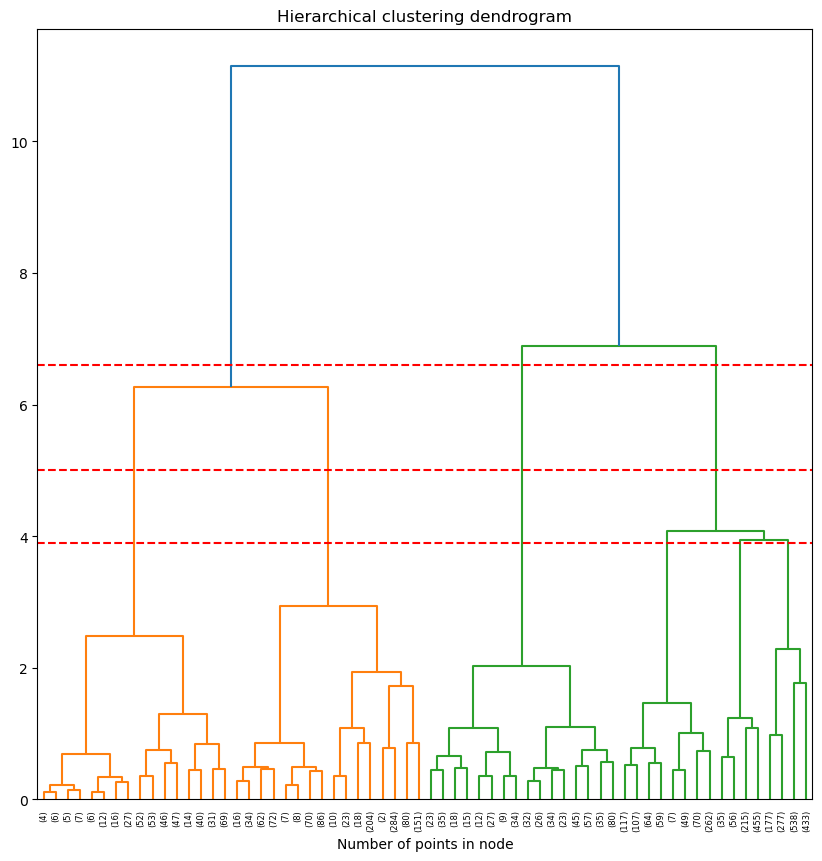

In [22]:
agg_cluster = AgglomerativeClustering(distance_threshold=0, n_clusters=None).fit(crime_clus_median)

fig, ax = plt.subplots(figsize = (10,10))
ax.set_title("Hierarchical clustering dendrogram")
#plot the top three levels of the dendrogram
plot_dendrogram(agg_cluster, truncate_mode='level', p=5)
plt.axhline(y = 3.9, color = "r", linestyle = "--")
plt.axhline(y = 5, color = "r", linestyle = "--")
plt.axhline(y = 6.6, color = "r", linestyle = "--")
ax.set_xlabel("Number of points in node")
plt.show()

From the dendrogram, we observe that there are **four prominent vertical lines** that are significantly longer than the others, indicating that the clusters they represent are relatively **well-separated** from each other. 

These lines can be cut at a distance of **5**. Therefore, we set the distance threshold to 5, which results in the dataset being divided into four distinct clusters.

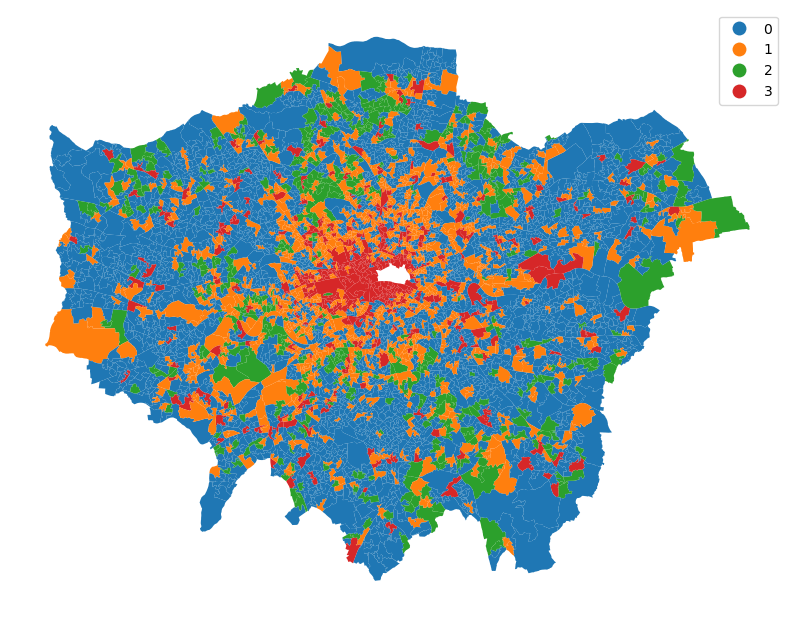

In [23]:
# Perform Agglomerative Clustering with a distance threshold of 5 to obtain 4 clusters
agg_cluster_5 = AgglomerativeClustering(linkage="ward", distance_threshold=5, n_clusters=None)
agg_cluster_5.fit(crime_clus_median)

# Add clustering results to the original dataset
london_crime_median["Aggl_clus"] = agg_cluster_5.labels_

# Define a custom color list (ensure it has at least as many colors as clusters)
custom_colors = ["#1f77b4", "#ff7f0e", "#2ca02c", "#d62728"]

# Create a custom colormap based on the number of unique clusters
n_clusters = london_crime_median["Aggl_clus"].nunique()
cmap = ListedColormap(custom_colors[:n_clusters])

# Plot the clustering results on a map
fig, ax = plt.subplots(figsize=(10, 10))
london_crime_median.plot(
    column="Aggl_clus",
    categorical=True,
    legend=True,
    cmap=cmap,
    ax=ax
)

# Hide axes for better visualization
ax.set_axis_off()


In [24]:
agglom_sizes = london_crime_median.groupby("Aggl_clus").size()
agglom_sizes

Aggl_clus
0    2921
1    1127
2     505
3     435
dtype: int64

In [25]:
# Calculate the mean values of the specified columns for each cluster
# Group the data by the "Aggl_clus" column and compute the mean for each cluster
agglom_means = london_crime_median.groupby("Aggl_clus")[cols_to_sum].mean()
agglom_means

,ARSON AND CRIMINAL DAMAGE,BURGLARY,DRUG OFFENCES,MISCELLANEOUS CRIMES AGAINST SOCIETY,POSSESSION OF WEAPONS,PUBLIC ORDER OFFENCES,ROBBERY,THEFT,VEHICLE OFFENCES,VIOLENCE AGAINST THE PERSON
Aggl_clus,,,,,,,,,,
0,0.083598,0.073982,0.050222,0.015012,0.006333,0.068932,0.024905,0.144295,0.153655,0.379057
1,0.067119,0.084911,0.043106,0.010832,0.005273,0.067980,0.037918,0.277971,0.149845,0.255047
2,0.077545,0.106464,0.031198,0.011291,0.002467,0.048226,0.018956,0.127662,0.336704,0.239482
3,0.044306,0.054785,0.033574,0.006349,0.004565,0.058620,0.041589,0.500651,0.067794,0.187764


In [26]:
# Transpose the DataFrame (swap rows and columns), then round all numerical values to three decimal places.
agglom_means_T = agglom_means.T.round(3)
#agglom_means_T.reset_index(inplace=True)
agglom_means_T = pd.DataFrame(agglom_means_T)
agglom_means_T

Aggl_clus,0,1,2,3
ARSON AND CRIMINAL DAMAGE,0.084,0.067,0.078,0.044
BURGLARY,0.074,0.085,0.106,0.055
DRUG OFFENCES,0.050,0.043,0.031,0.034
MISCELLANEOUS CRIMES AGAINST SOCIETY,0.015,0.011,0.011,0.006
POSSESSION OF WEAPONS,0.006,0.005,0.002,0.005
PUBLIC ORDER OFFENCES,0.069,0.068,0.048,0.059
ROBBERY,0.025,0.038,0.019,0.042
THEFT,0.144,0.278,0.128,0.501
VEHICLE OFFENCES,0.154,0.150,0.337,0.068
VIOLENCE AGAINST THE PERSON,0.379,0.255,0.239,0.188


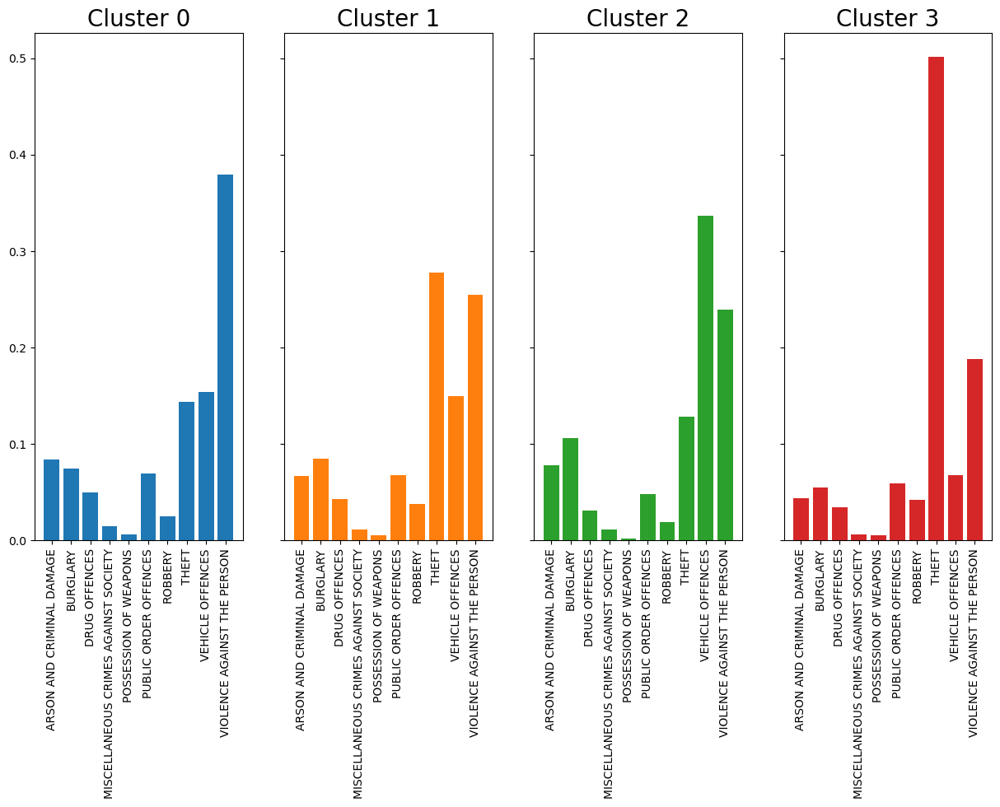

In [27]:
agglom_means_T.reset_index(inplace=True)

#create subplots for each cluster
fig, ax = plt.subplots(1,4, figsize = (15,8), sharey = True, sharex = True)
#flatten the axis
axis = ax.flatten()

#going over each column
for i, col in enumerate(agglom_means_T.columns):
    #ignore the index column
    if col != "index":
        ax = axis[i-1]
        #plot the bar chart
        ax.bar(height = agglom_means_T[col], x=agglom_means_T["index"], color = custom_colors[i-1] )
        # set the x-ticks
        ax.set_xticks(range(len(agglom_means_T["index"])))  # Set x-ticks explicitly
        # set the x-tick labels
        ax.set_xticklabels(labels=agglom_means_T["index"], rotation=90)
        #set the title
        ax.set_title(f"Cluster {col}", fontsize = 20)

Based on the dendrogram analysis, four clusters were identified. Among them, Cluster 0 has the **largest** proportion, consisting of 2,921 LSOAs. Cluster 1, 2, and 3 have 1,127, 505, and 435 LSOAs respectively.

From the **"Crime Features Across Clusters"** plot, we observe the following:

- **Cluster 1** is primarily characterized by a high rate of **violence against the person**, accompanied by a relatively higher occurrence of **arson and criminal damage** and **drug offences** crimes.
- **Cluster 2** exhibits a notable presence of both **theft** and **violence against the person** crimes, suggesting that these two crime types may tend to occur together.
- **Cluster 3** stands out due to its high rate of **vehicle offences**, along with the highest frequency of **burglary**.
- **Cluster 4** is predominantly driven by **theft**, which accounts for about half of all the crime cases in this cluster. Additionally, **vehicle offences** are notably low in this cluster, indicating that these two types of crimes tend not to occur simultaneously. However, **robbery** is relatively frequent, suggesting a possible correlation with **theft**.


### Chi-Square Analysis of Crime Rate and Clusters

In [28]:
# Divide 'crime_per_km2' into 8 quantile-based categories
quantiles = london_crime_median['crime_per_km2'].quantile([0, 0.125, 0.25, 0.375, 0.5, 0.625, 0.75, 0.875, 1.0])
bins = quantiles.values
labels = ['Very Low', 'Low', 'Medium-Low', 'Medium', 'Medium-High', 'High', 'Very High', 'Extremely High']

# Assign crime density categories based on quantile bins
london_crime_median['crime_density_category'] = pd.cut(
    london_crime_median['crime_per_km2'], 
    bins=bins, 
    labels=labels, 
    include_lowest=True
)

# Perform Chi-Square test to check for association between cluster and crime density category
contingency_table = pd.crosstab(london_crime_median['Aggl_clus'], london_crime_median['crime_density_category'])

# Apply Chi-Square test of independence
chi2, p, _, _ = chi2_contingency(contingency_table)

print("Chi-Square p-value:", p)
print("Chi-Square Statistic:", chi2)
print("Degrees of Freedom:", (contingency_table.shape[0] - 1) * (contingency_table.shape[1] - 1))
# print("Contingency Table:\n", contingency_table)


Chi-Square p-value: 0.0
Chi-Square Statistic: 1644.08536410112
Degrees of Freedom: 21


With a *p-value close to zero and a large chi-square statistic*, we have strong evidence to reject the null hypothesis, indicating a significant association between Crime Rate and Clusters.


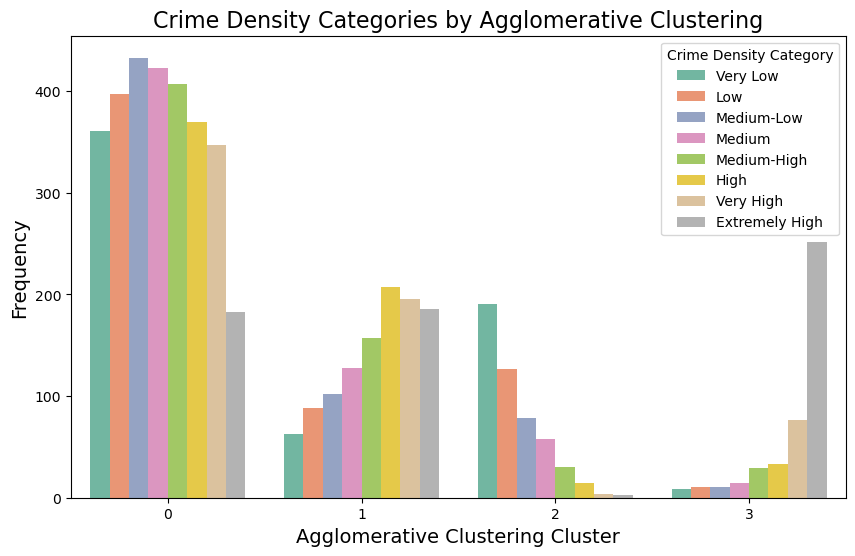

In [29]:
# Visualize chi-square analysis results

plt.figure(figsize=(10, 6))
sns.countplot(data=london_crime_median, x='Aggl_clus', hue='crime_density_category', palette='Set2')

# Set the title and label
plt.title('Crime Density Categories by Agglomerative Clustering', fontsize=16)
plt.xlabel('Agglomerative Clustering Cluster', fontsize=14)
plt.ylabel('Frequency', fontsize=14)
plt.legend(title='Crime Density Category', loc='upper right')

plt.show()

From the distribution, we observe clear spatial preferences among different clusters:

- **Cluster 1** (violence, arson and drug offences) is evenly spread across the city, suggesting these crimes occur regardless of the general crime intensity and may be driven by local or interpersonal factors.
- **Cluster 2** (theft and violence) and **Cluster 4** (theft and robbery) are concentrated in high-crime areas, indicating a tendency for these offences to cluster in urban hotspots—likely linked to high foot traffic and opportunity-rich environments.
- **Cluster 3** (vehicle offences and burglary) is more common in low-crime zones, pointing to a preference for suburban or less monitored areas.


## Conclusion

[[ go back to the top ]](#Table-of-contents)

### Key Findings

`Spatial and temporal distribution`
- Over the past decade, the total number of crimes in London has shown **a slight upward trend**. Notably, there was a significant drop in 2020 and 2021 compared to 2019, which aligns with the impact of the COVID-19 pandemic.
- Different major crime types display **distinct temporal and spatial patterns**. Their frequencies also differ considerably, indicating the diverse nature of criminal activities in the city.
- Despite these differences, the **spatial distribution of each crime type has remained relatively consistent over time**, indicating these crime types may be subject to underlying geographic and socio-economic determinants, leading to relatively structured spatial patterns.

`There are indeed underlying relationships between different crime types and associated with crime density`
- Potential relationships exist between different types of crimes. For example, **theft**, **violence against the person**, and **robbery** tend to co-occur, particularly in high-crime areas. In contrast, **vehicle offences** and **burglary** are more prevalent in low-crime areas.

### Significance of the Study

This study provides a comprehensive and in-depth analysis of major crime types in London by integrating both temporal and spatial dimensions. The consistency and cross-validation of various analyses enhance the credibility of the findings. The effective use of crime data demonstrates how spatial-temporal analytics and clustering methods can support evidence-based policy making.

### Policy Implications

- Targeted governance efforts are needed for major crime types, especially **theft**, **violence against the person**, and **vehicle offences**. Besides, those crime types which show an upward trend in recent years, such as **public order offences**, should be prioritized for intervention.
- Spatial distribution maps can guide focused policing. For instance, if a specific LSOA consistently shows high values for **public order offences** over multiple years, it should be prioritized for intervention.
- **Chi-Square Analysis** shows that different crime types require tailored prevention strategies. High-theft clusters may benefit from targeted interventions in commercial and densely populated areas, while burglary and vehicle crime prevention should focus on residential design and surveillance in quieter neighborhoods.


In [30]:
end_time = time.time() 
run_time = end_time - start_time 
print("Total run time: ", run_time, "seconds") 

Total run time:  330.52668952941895 seconds


## References

[[ go back to the top ]](#Table-of-contents)

Chainey, S., Tompson, L., & Uhlig, S. (2008). The utility of hotspot mapping for predicting spatial patterns of crime. Security journal, 21(1), 4-28.

Joshi, A., Sabitha, A. S., & Choudhury, T. (2017). Crime analysis using K-means clustering. In 2017 3rd International conference on computational intelligence and networks (CINE) (pp. 33-39). IEEE.

Nakaya, T., & Yano, K. (2010). Visualising crime clusters in a space‐time cube: An exploratory data‐analysis approach using space‐time kernel density estimation and scan statistics. Transactions in GIS, 14(3), 223-239.